In [3]:
# core
import os
import sys
import time
import random

# custom
sys.path.append('../code/poloniex')
sys.path.append('../code')
import polo_eda as pe
import prep_for_nn as pfn
import calc_TA_sigs as cts
import data_processing as dp
from utils import get_home_dir

# installed
import pandas as pd
import numpy as np
import statsmodels.api as sm
from keras.layers import Input, Dense, Dropout, BatchNormalization, LSTM, RepeatVector
from keras.models import Model
from keras.callbacks import EarlyStopping
from keras.regularizers import l1_l2
import keras.backend as K
from keras.models import load_model
import keras.losses
from sklearn.preprocessing import StandardScaler as SS
from tqdm import tqdm_notebook as tqdm
import h5py
import tensorflow as tf

# plotting
import plotly
plotly.offline.init_notebook_mode()
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import Scatter, Figure, Layout, Candlestick
from plotly.tools import FigureFactory as FF
import plotly.graph_objs as go
import matplotlib.pyplot as plt
%matplotlib inline

# these next cells are in the pfn.prep_for_nn() function now...skip ahead to just before custom loss funcs

In [2]:
mkt = 'BTC_STR'  # used later to read hdf5 file
df = pe.read_trade_hist(mkt)

In [3]:
# resamples to the hour
rs_full = dp.resample_ohlc(df, resamp='H')

In [4]:
rs_full = dp.make_mva_features(rs_full)

In [5]:
bars = cts.create_tas(bars=rs_full, verbose=True)

using multiplier of 1000000


In [6]:
indicators = ['bband_u_cl', # bollinger bands
             'bband_m_cl',
             'bband_l_cl',
             'bband_u_tp',
             'bband_m_tp',
             'bband_l_tp',
             'bband_u_cl_diff',
             'bband_m_cl_diff',
             'bband_l_cl_diff',
             'bband_u_cl_diff_hi',
             'bband_l_cl_diff_lo',
             'bband_u_tp_diff',
             'bband_m_tp_diff',
             'bband_l_tp_diff',
             'bband_u_tp_diff_hi',
             'bband_l_tp_diff_lo',
             'dema_cl',
             'dema_tp',
             'dema_cl_diff',
             'dema_tp_diff',
             'ema_cl',
             'ema_tp',
             'ema_cl_diff',
             'ema_tp_diff',
             'ht_tl_cl',
             'ht_tl_tp',
             'ht_tl_cl_diff',
             'ht_tl_tp_diff',
             'kama_cl',
             'kama_tp',
             'kama_cl_diff',
             'kama_tp_diff',
            #  'mama_cl',  # having problems with these
            #  'mama_tp',
            #  'fama_cl',
            #  'fama_tp',
            #  'mama_cl_osc',
            #  'mama_tp_osc',
             'midp_cl',
             'midp_tp',
             'midp_cl_diff',
             'midp_tp_diff',
             'midpr',
             'midpr_diff',
             'sar',
             'sar_diff',
             'tema_cl',
             'tema_tp',
             'tema_cl_diff',
             'tema_tp_diff',
             'trima_cl',
             'trima_tp',
             'trima_cl_diff',
             'trima_tp_diff',
             'wma_cl',
             'wma_tp',
             'wma_cl_diff',
             'wma_tp_diff',
             'adx',
             'adxr',
             'apo_cl',
             'apo_tp',
             'arup', # aroon
             'ardn',
             'aroonosc',
             'bop',
             'cci',
             'cmo_cl',
             'cmo_tp',
             'dx',
             'macd_cl',
             'macdsignal_cl',
             'macdhist_cl',
             'macd_tp',
             'macdsignal_tp',
             'macdhist_tp',
             'mfi',
             'mdi',
             'mdm',
             'mom_cl',
             'mom_tp',
             'pldi',
             'pldm',
             'ppo_cl',
             'ppo_tp',
             'roc_cl',
             'roc_tp',
             'rocp_cl',
             'rocp_tp',
             'rocr_cl',
             'rocr_tp',
             'rocr_cl_100',
             'rocr_tp_100',
             'rsi_cl',
             'rsi_tp',
             'slowk', # stochastic oscillator
             'slowd',
             'fastk',
             'fastd',
             'strsi_cl_k',
             'strsi_cl_d',
             'strsi_tp_k',
             'strsi_tp_d',
             'trix_cl',
             'trix_tp',
             'ultosc',
             'willr',
             'ad',
             'adosc',
             'obv_cl',
             'obv_tp',
             'atr',
             'natr',
             'trange',
             'ht_dcp_cl',
             'ht_dcp_tp',
             'ht_dcph_cl',
             'ht_dcph_tp',
             'ht_ph_cl',
             'ht_ph_tp',
             'ht_q_cl',
             'ht_q_tp',
             'ht_s_cl',
             'ht_s_tp',
             'ht_ls_cl',
             'ht_ls_tp',
             'ht_tr_cl',
             'ht_tr_tp'
             ]

In [7]:
lin_inds = ['bband_m_cl_diff',
            'bband_m_tp_diff',
            'dema_cl_diff',
            'dema_tp_diff',
            'ema_cl_diff',
            'ema_tp_diff',
            'kama_cl_diff',
            'kama_tp_diff',
            'ht_tl_cl_diff',
            'ht_tl_tp_diff',
            'kama_cl_diff',
            'kama_tp_diff',
            'midp_cl_diff',
            'midp_tp_diff',
            'midpr_diff',
            'sar_diff',
            'tema_cl_diff',
            'tema_tp_diff',
            'trima_cl_diff',
            'trima_tp_diff',
            'wma_cl_diff',
            'wma_tp_diff',
            'apo_cl',
            'apo_tp',
            'cci',
            'cmo_cl',
            'cmo_tp',
            'macdhist_cl',
            'macdhist_tp',
            'mom_cl',
            'mom_tp',
            'ppo_cl',
            'ppo_tp',
            'roc_cl',
            'roc_tp',
            'rocp_cl',
            'rocp_tp',
            'rocr_cl',
            'rocr_tp',
            'rocr_cl_100',
            'rocr_tp_100',
            'rsi_cl',
            'rsi_tp',
            'ht_ph_cl',
            'ht_ph_tp']
# others that are bound to a range, not price data
other_inds = ['adx',
                'adxr',
                'arup', # aroon
                'ardn',
                'aroonosc',
                'bop',
                'dx',
                'macd_cl',
                'macdsignal_cl',
                'macd_tp',
                'macdsignal_tp',
                'mfi',
                'mdi',
                'mdm',
                'pldi',
                'pldm',
                'slowk', # stochastic oscillator
                'slowd',
                'fastk',
                'fastd',
                'strsi_cl_k',
                'strsi_cl_d',
                'strsi_tp_k',
                'strsi_tp_d',
                'trix_cl',
                'trix_tp',
                'ultosc',
                'willr',
                'ad',
                'adosc',
                'obv_cl',
                'obv_tp',
                'atr',
                'natr',
                'trange',
                'ht_dcp_cl',
                'ht_dcp_tp',
                'ht_dcph_cl',
                'ht_dcph_tp',
                'ht_q_cl',
                'ht_q_tp',
                'ht_s_cl',
                'ht_s_tp',
                'ht_ls_cl',
                'ht_ls_tp',
                'ht_tr_cl',
                'ht_tr_tp']

In [8]:
# make target columns
col = '24h_price_diff'
bars[col] = bars['typical_price'].copy()
bars[col] = np.hstack((np.repeat(bars[col].iloc[24], 24), bars['typical_price'].iloc[24:].values - bars['typical_price'].iloc[:-24].values))
bars['24h_price_diff_pct'] = bars[col] / np.hstack((np.repeat(bars['typical_price'].iloc[24], 24), bars['typical_price'].iloc[24:].values))

In [9]:
# drop first 24 points
bars = bars.iloc[24:]
# also drop first 1000 points because usually they are bogus
bars = bars.iloc[1000:]

In [10]:
feat_cols_full = indicators + ['mva_tp_24_diff', 'direction_volume', 'volume']
feat_cols = lin_inds + other_inds + ['mva_tp_24_diff', 'direction_volume', 'volume']
feat_cols = indicators + ['mva_tp_24_diff', 'direction_volume', 'volume']
features = bars[feat_cols].values

In [11]:
# make historical features
hist_points = 480
new_feats = []
for i in range(hist_points, features.shape[0]):
    new_feats.append(features[i - hist_points:i, :])

new_feats = np.array(new_feats)

In [12]:
new_feats.shape

(26267, 480, 125)

In [13]:
# new_feats = new_feats.reshape((new_feats.shape[0], -1))

In [14]:
set(feat_cols_full).difference(set(feat_cols))

set()

In [15]:
features.shape

(26747, 125)

In [12]:
targets = bars['24h_price_diff_pct'].iloc[hist_points:].values

In [13]:
targets.shape

(26267,)

In [14]:
test_size = 5000
train_feats = new_feats[:-test_size]
train_targs = targets[:-test_size]
test_feats = new_feats[-test_size:]
test_targs = targets[-test_size:]

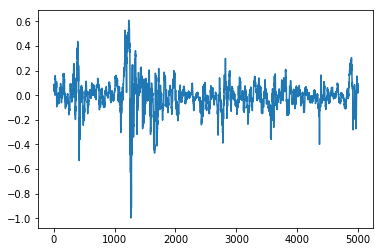

In [19]:
plt.plot(test_targs)

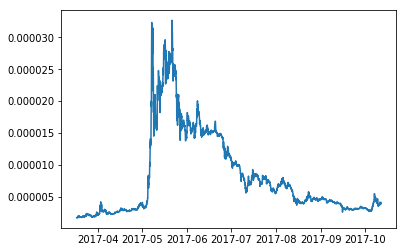

In [20]:
plt.plot(bars['typical_price'].iloc[-5000:])

first net tried was 

```python
inputs = Input(shape=(125,))
x = Dense(128, activation='elu')(inputs)
x = Dense(64, activation='elu')(x)
predictions = Dense(1, activation='linear')(x)
```

with the indicators and ['mva_tp_24_diff', 'direction_volume']

however it was overfitting, a histogram of the weights showed some very large outliers

adding 0.5 dropout after both dense layers helped a lot.  Loss at about 0.002

adding batchnorm after the dense layers improved loss to about 0.0012 for train, but 0.241 for val.  Some big outliers

```python
inputs = Input(shape=(125,))
x = Dense(128, activation='elu')(inputs)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(64, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation='linear')(x)
```

adding kernel regularizers with l1_l2 seemed to help, but had to use very small values.  adding activation regs didn't seem to help with l1_l2, no matter how small the values

this model seemed to work ok on future predictions, but still had a lot of really large positive predictions, when the actual was all over the place

```python
inputs = Input(shape=(125,))
x = Dense(512, activation='elu', kernel_regularizer=l1_l2(1e-6))(inputs)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='elu', kernel_regularizer=l1_l2(1e-8))(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(64, activation='elu', kernel_regularizer=l1_l2(1e-8))(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(16, activation='elu', kernel_regularizer=l1_l2(1e-8))(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation='linear')(x)
```

whoops!  forgot to normalize the input to a consistent range.  After doing that, didn't seem to actually help much

tried this model without using MVA-type indicators, didn't seem to work well
```python
inputs = Input(shape=(95,))
x = Dense(512, activation='elu')(inputs)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(64, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(16, activation='elu')(x)
x = BatchNormalization()(x)
predictions = Dense(1, activation='linear')(x)
```

next thing to try: make groups of time periods and normalize prices/mvas within those ranges, use the ranges as batches to train on

also add historical (like last 48h) of each kind of indicator

without normalizing as is, seems to do ok.  After normalizing, doesn't do well

In [ ]:
# this is for not using historical data
scalers = []
xform_train = []
xform_test = []
for i in range(train_feats.shape[1]):
    s = SS()
    scalers.append(s)
    xform_train.append(s.fit_transform(train_feats[:, i].reshape(-1, 1))[:, 0])
    xform_test.append(s.transform(test_feats[:, i].reshape(-1, 1))[:, 0])
    
xform_train = np.array(xform_train).reshape(train_feats.shape[0], train_feats.shape[1])
xform_test = np.array(xform_test).reshape(test_feats.shape[0], test_feats.shape[1])

In [60]:
train_feats[0].shape

(480, 125)

In [65]:
train_feats.shape

(21267, 480, 125)

In [16]:
# home_dir = get_home_dir()  # data too big for this right now
home_dir = '/media/nate/data_lake/crytpo_predict/'

for d in [home_dir + 'data', home_dir + 'data/nn_feats_targs', home_dir + 'data/nn_feats_targs/poloniex']:
    if not os.path.exists(d):
        os.mkdir(d)

In [17]:
# for historical data, use this
datafile = home_dir + 'data/nn_feats_targs/poloniex/' + mkt
if os.path.exists(datafile):
    print('loading...')
    f = h5py.File(datafile, 'r')
    xform_train = f['xform_train'][:]
    xform_test = f['xform_test'][:]
    train_targs = f['train_targs'][:]
    test_targs = f['test_targs'][:]
    f.close()
else:
    print('creating new...')
    xform_train = []
    xform_test = []
    s = SS()
    for j in tqdm(range(train_feats.shape[0])):  # timesteps
        xform_train_ts = []
        for i in range(train_feats.shape[2]):  # number of indicators/etc
            xform_train_ts.append(s.fit_transform(train_feats[j, :, i].reshape(-1, 1))[:, 0])

        xform_train_ts = np.array(xform_train_ts).reshape(train_feats.shape[1], train_feats.shape[2])
        xform_train.append(xform_train_ts)

    for j in tqdm(range(test_feats.shape[0])):
        xform_test_ts = []
        for i in range(test_feats.shape[2]):  # number of indicators/etc
            xform_test_ts.append(s.fit_transform(test_feats[j, :, i].reshape(-1, 1))[:, 0])

        xform_test_ts = np.array(xform_test_ts).reshape(test_feats.shape[1], test_feats.shape[2])
        xform_test.append(xform_test_ts)

    xform_train = np.array(xform_train).reshape(train_feats.shape[0], train_feats.shape[1], train_feats.shape[2])
    xform_test = np.array(xform_test).reshape(test_feats.shape[0], test_feats.shape[1], test_feats.shape[2])

    f = h5py.File(datafile, 'w')
    f.create_dataset('xform_train', data=xform_train)
    f.create_dataset('xform_test', data=xform_test)
    f.create_dataset('train_targs', data=train_targs)
    f.create_dataset('test_targs', data=test_targs)
    f.close()

loading...


In [283]:
# this is for no historical data
# restart keras session (clear weights)
K.clear_session()
# neural network basic model
inputs = Input(shape=(train_feats.shape[0],))
x = Dense(512, activation='elu')(inputs)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(64, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(16, activation='elu')(x)
x = BatchNormalization()(x)
predictions = Dense(1, activation='linear')(x)

es = EarlyStopping(monitor='val_loss', min_delta=0, patience=5, verbose=0, mode='auto')
cb = [es]

model = Model(inputs=inputs, outputs=predictions)
model.compile(optimizer='rmsprop',
              loss='mean_squared_error')

In [284]:
model.fit(xform_train, train_targs, epochs=50, validation_split=0.1, callbacks=cb)

Train on 18650 samples, validate on 2073 samples
Epoch 1/50
18650/18650 [==============================] - 2s - loss: 0.0340 - val_loss: 0.0027
Epoch 2/50
18650/18650 [==============================] - 2s - loss: 0.0039 - val_loss: 0.0023
Epoch 3/50
18650/18650 [==============================] - 2s - loss: 0.0037 - val_loss: 0.0026
Epoch 4/50
18650/18650 [==============================] - 2s - loss: 0.0037 - val_loss: 0.0021
Epoch 5/50
18650/18650 [==============================] - 2s - loss: 0.0036 - val_loss: 0.0021
Epoch 6/50
18650/18650 [==============================] - 2s - loss: 0.0036 - val_loss: 0.0030
Epoch 7/50
18650/18650 [==============================] - 2s - loss: 0.0036 - val_loss: 0.0028
Epoch 8/50
18650/18650 [==============================] - 2s - loss: 0.0036 - val_loss: 0.0027
Epoch 9/50
18650/18650 [==============================] - 2s - loss: 0.0035 - val_loss: 0.0023
Epoch 10/50
18650/18650 [==============================] - 2s - loss: 0.0035 - val_loss: 0.0024


In [296]:
preds = model.predict(xform_train)[:, 0]
data = [Scatter(x=preds, y=train_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [286]:
preds = model.predict(xform_test)[:, 0]
data = [Scatter(x=preds, y=test_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [289]:
layers = model.layers

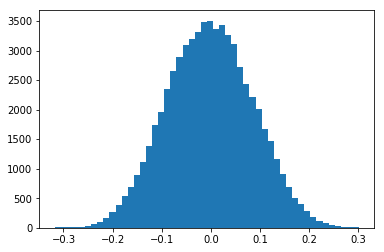

In [290]:
# dense 1
h = plt.hist(layers[1].get_weights()[0].flatten(), bins=50)

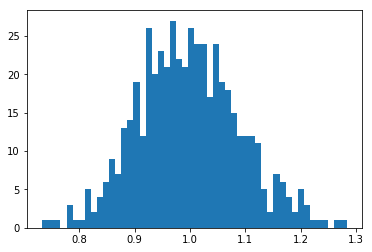

In [291]:
# batchnorm
h = plt.hist(layers[2].get_weights()[0].flatten(), bins=50)

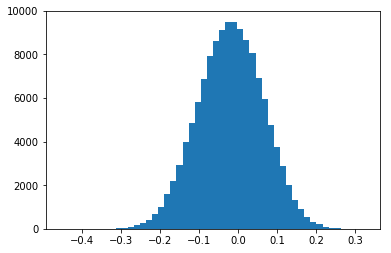

In [292]:
h = plt.hist(layers[4].get_weights()[0].flatten(), bins=50)

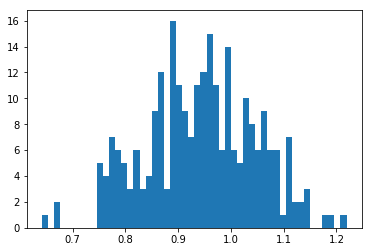

In [293]:
h = plt.hist(layers[5].get_weights()[0].flatten(), bins=50)

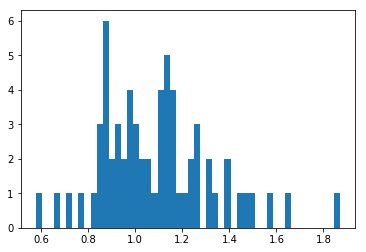

In [294]:
h = plt.hist(layers[7].get_weights()[0].flatten(), bins=50)

In [295]:
for l in layers:
    print(l.name)

input_1
dense_1
batch_normalization_1
dropout_1
dense_2
batch_normalization_2
dense_3
batch_normalization_3
dense_4
batch_normalization_4
dense_5


In [42]:
xform_train.shape

(21267, 480, 125)

In [83]:
np.std(random.sample(list(xform_train[:, :, 2].flatten()), 10000))

1.0229634107719949

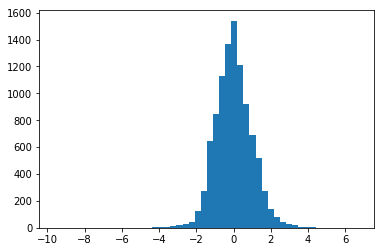

In [84]:
h = plt.hist(random.sample(list(xform_train[:, :, 2].flatten()), 10000), bins=50)

In [123]:
# restart keras session (clear weights)
K.clear_session()

timesteps = train_feats.shape[1]
latent_dim = 1000
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps, input_dim))  # timesteps, input_dim
encoded = LSTM(latent_dim)(inputs)

decoded = RepeatVector(timesteps)(encoded)
decoded = LSTM(input_dim, return_sequences=True)(decoded)

sequence_autoencoder = Model(inputs, decoded)
encoder = Model(inputs, encoded)

In [87]:
sequence_autoencoder.compile(optimizer='rmsprop', loss='mse')

In [88]:
es = EarlyStopping(monitor='val_loss', min_delta=0, patience=5, verbose=0, mode='auto')
cb = [es]

sequence_autoencoder.fit(xform_train, xform_train, epochs=50, validation_split=0.1, callbacks=cb)

Train on 19140 samples, validate on 2127 samples
Epoch 1/50
19140/19140 [==============================] - 607s - loss: 1.0001 - val_loss: 1.0000
Epoch 2/50
19140/19140 [==============================] - 607s - loss: 1.0000 - val_loss: 1.0000
Epoch 3/50
19140/19140 [==============================] - 610s - loss: 1.0000 - val_loss: 1.0000
Epoch 4/50
19140/19140 [==============================] - 606s - loss: 1.0000 - val_loss: 1.0000
Epoch 5/50
12928/19140 [===================>..........] - ETA: 191s - loss: 1.0000

KeyboardInterrupt: 

lstm 3-layer:

timesteps = train_feats.shape[1]
lstm_dim = 500
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps, input_dim))  # timesteps, input_dim
x = LSTM(lstm_dim, return_sequences=True)(inputs)
x = LSTM(lstm_dim)(inputs)
x = Dropout(0.4)(x)
x = Dense(250, activation='elu')(x)
x = Dropout(0.2)(x)
x = Dense(100, activation='elu')(x)
x = Dropout(0.2)(x)
x = Dense(50, activation='elu')(x)
x = Dense(1, activation='linear')(x)

got about 0.0015 mse

lstm2 3-layer:
timesteps = train_feats.shape[1]
lstm_dim = 500
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps, input_dim))  # timesteps, input_dim
x = LSTM(lstm_dim, dropout=0.4, return_sequences=True)(inputs)
x = LSTM(lstm_dim)(x)
x = Dropout(0.4)(x)
x = Dense(250, activation='elu')(x)
x = Dropout(0.2)(x)
x = Dense(100, activation='elu')(x)
x = Dropout(0.2)(x)
x = Dense(50, activation='elu')(x)
x = Dense(1, activation='linear')(x)

about 0.0010 mse

mean_absolute_percentage_error seems to not work so well so far, it takes a really long time to converge

mean_squared_logarithmic_error almost works, but not for negative numbers

that was all using rmsprop

mapel didn't seem to work with adam

tried mean_squared_abs_log_error, didn't quite seem to work right.  lots of big predictions that were actually near 0

# start here

In [4]:
xform_train, xform_test, train_targs, test_targs = pfn.prep_polo_nn()

loading...


In [7]:
# custom loss functions
def mean_absolute_percentage_error_log(y_true, y_pred):
    diff = K.log(K.abs((y_true - y_pred) / K.clip(K.abs(y_true),
                                            K.epsilon(),
                                            None)))
    return 100. * K.mean(diff, axis=-1)


def mean_squared_abs_log_error(y_true, y_pred):
    if K.less(y_true, 0) is True:
        if K.less(y_pred, 0) is True:
            first_log = K.log(K.clip(-y_pred, K.epsilon(), None) + 1.)
            second_log = K.log(K.clip(-y_true, K.epsilon(), None) + 1.)
            return K.mean(K.square(first_log - second_log), axis=-1)
        
    first_log = K.log(K.clip(y_pred, K.epsilon(), None) + 1.)
    second_log = K.log(K.clip(y_true, K.epsilon(), None) + 1.)
        
    return K.mean(K.square(first_log - second_log), axis=-1)


def mean_squared_error_log(y_true, y_pred):
    return K.mean(K.log(K.square(y_pred - y_true) + 1.), axis=-1)


def mean_squared_error_log_pct(y_true, y_pred):
    # doesn't seem to work -- somethin with teh derivative i'm sure
    return K.mean(K.log(K.square(y_pred - y_true) / K.square(K.clip(K.abs(y_true), K.epsilon(), None)) + 1.), axis=-1)


def stock_loss(y_true, y_pred):
    alpha = 100.
    loss = tf.where(K.less(y_true * y_pred, 0), \
                     alpha*y_pred**2 - K.sign(y_true)*y_pred + K.abs(y_true), \
                     K.abs(y_true - y_pred))
        
    return K.mean(loss, axis=-1)


def stock_loss_log(y_true, y_pred):
    alpha = 100.
    loss = tf.where(K.less(y_true * y_pred, 0), \
                     K.log(alpha*y_pred**2 - K.sign(y_true)*y_pred + K.abs(y_true) + 1), \
                     K.log(K.abs(y_true - y_pred) + 1))

    return K.mean(loss, axis=-1)


def stock_loss_mae_log(y_true, y_pred):
    alpha = 5.
    loss = tf.where(K.less(y_true * y_pred, 0), \
                     alpha * K.log(K.abs(y_true - y_pred) + 1), \
                     K.log(K.abs(y_true - y_pred) + 1))

    return K.mean(loss, axis=-1)


def stock_loss_log2(y_true, y_pred):
    alpha = 10000.
    loss = tf.where(K.less(y_true * y_pred, 0), \
                     alpha*y_pred**2 - K.sign(y_true)*y_pred + K.abs(y_true), \
                     K.log(K.abs(y_true - y_pred) + 1))

    return K.mean(loss, axis=-1)


def stock_loss_mse_log_pct(y_true, y_pred):
    # doesn't seem to work -- somethin with teh derivative i'm sure
    alpha = 100.
    loss = tf.where(K.less(y_true * y_pred, 0), \
                     alpha*y_pred**2 - K.sign(y_true)*y_pred + K.abs(y_true), \
                     K.log(K.square(y_pred - y_true) / K.square(K.clip(y_true, K.epsilon(), None)) + 1.))
    
    return K.mean(loss, axis=-1)


def mse_log_pct_direction(y_true, y_pred):
    # doesn't seem to work -- somethin with teh derivative i'm sure
    # adds a penalty if the predicted direction is wrong
    alpha = 0  # penalty factor for wrong direction -- 1 seems to be too big at first
    loss = K.log(K.square(y_pred - y_true) / 
                 K.square(K.clip(K.abs(y_true), K.epsilon(), None)) + \
                 # so the log will never be negative
                 1. \
                 # wrong direction penalty
                 - alpha * (y_pred * y_true - K.abs(y_pred * y_true)) / K.clip(K.abs(y_pred * y_true), K.epsilon(), None))
    
    return K.mean(loss, axis=-1)

In [8]:
keras.losses.mean_squared_error_log = mean_squared_error_log
keras.losses.stock_loss_log = stock_loss_log
keras.losses.stock_loss_mse_log_pct = stock_loss_mse_log_pct
keras.losses.mse_log_pct_direction = mse_log_pct_direction
keras.losses.stock_loss = stock_loss
keras.losses.stock_loss_log = stock_loss_log
keras.losses.stock_loss_log2 = stock_loss_log2
keras.losses.stock_loss_mae_log = stock_loss_mae_log

# simple net to test loss functions

In [136]:
# restart keras session (clear weights)
K.clear_session()

timesteps = train_feats.shape[1]
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps*input_dim, ))  # timesteps, input_dim
x = Dense(1000, activation='elu')(inputs)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(500, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(100, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(1, activation='linear')(x)

In [137]:
es = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=0, mode='auto')
cb = [es]

mod = Model(inputs, x)
# also try mean_squared_logarithmic_error
# mean_absolute_percentage_error
# was using mse before, but then small % changes aren't predicted very well
mod.compile(optimizer='adam', loss=stock_loss_mae_log)

In [138]:
old_mod = load_model('simple_3_layer_30epochs_stock_loss_log2_alpha1000.h5')
for i, l in enumerate(old_mod.layers):
    mod.layers[i].set_weights(l.get_weights())

In [144]:
mod.fit(xform_train.reshape(xform_train.shape[0], -1), train_targs, epochs=30, validation_split=0.15, callbacks=cb, batch_size=1000)

Train on 18076 samples, validate on 3191 samples
Epoch 1/30
18076/18076 [==============================] - 4s - loss: 0.0244 - val_loss: 0.2919
Epoch 2/30
18076/18076 [==============================] - 4s - loss: 0.0235 - val_loss: 0.1819
Epoch 3/30
18076/18076 [==============================] - 4s - loss: 0.0208 - val_loss: 0.0722
Epoch 4/30
18076/18076 [==============================] - 4s - loss: 0.0216 - val_loss: 0.1710
Epoch 5/30
18076/18076 [==============================] - 4s - loss: 0.0210 - val_loss: 0.1617
Epoch 6/30
18076/18076 [==============================] - 4s - loss: 0.0219 - val_loss: 0.1529
Epoch 7/30
18076/18076 [==============================] - 4s - loss: 0.0204 - val_loss: 0.1433
Epoch 8/30
18076/18076 [==============================] - 4s - loss: 0.0208 - val_loss: 0.0954
Epoch 9/30
18076/18076 [==============================] - 4s - loss: 0.0189 - val_loss: 0.0846
Epoch 10/30
18076/18076 [==============================] - 4s - loss: 0.0193 - val_loss: 0.1757


In [145]:
mod.evaluate(xform_test.reshape(xform_test.shape[0], -1), test_targs)

4960/5000 [============================>.] - ETA: 0s

0.075865165528655049

In [146]:
past_preds = mod.predict(xform_train.reshape(xform_train.shape[0], -1))[:, 0]
data = [Scatter(x=past_preds, y=train_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [147]:
preds = mod.predict(xform_test.reshape(xform_test.shape[0], -1))[:, 0]
data = [Scatter(x=preds, y=test_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [148]:
mod.save('simple_3_layer_30epochs_stock_loss_mae_log_alpha5.h5')

# bigger dense net to see if can match performance of LSTMs

In [65]:
# restart keras session (clear weights)
K.clear_session()

timesteps = train_feats.shape[1]
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps*input_dim, ))  # timesteps, input_dim
x = Dense(3000, activation='elu')(inputs)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(2000, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(1000, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(500, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(100, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(1, activation='linear')(x)

In [66]:
es = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=0, mode='auto')
cb = [es]

mod = Model(inputs, x)
# also try mean_squared_logarithmic_error
# mean_absolute_percentage_error
# was using mse before, but then small % changes aren't predicted very well
mod.compile(optimizer='adam', loss=stock_loss_mae_log)

In [82]:
mod.fit(xform_train.reshape(xform_train.shape[0], -1), train_targs, epochs=30, validation_split=0.15, callbacks=cb, batch_size=2000)

Train on 18076 samples, validate on 3191 samples
Epoch 1/30
18076/18076 [==============================] - 5s - loss: 0.0462 - val_loss: 0.0685
Epoch 2/30
18076/18076 [==============================] - 5s - loss: 0.0357 - val_loss: 0.0785
Epoch 3/30
18076/18076 [==============================] - 5s - loss: 0.0357 - val_loss: 0.0915
Epoch 4/30
18076/18076 [==============================] - 5s - loss: 0.0352 - val_loss: 0.0526
Epoch 5/30
18076/18076 [==============================] - 5s - loss: 0.0376 - val_loss: 0.0695
Epoch 6/30
18076/18076 [==============================] - 5s - loss: 0.0364 - val_loss: 0.0524
Epoch 7/30
18076/18076 [==============================] - 5s - loss: 0.0308 - val_loss: 0.0723
Epoch 8/30
18076/18076 [==============================] - 5s - loss: 0.0415 - val_loss: 0.0435
Epoch 9/30
18076/18076 [==============================] - 5s - loss: 0.0325 - val_loss: 0.0433
Epoch 10/30
18076/18076 [==============================] - 5s - loss: 0.0257 - val_loss: 0.0494


In [83]:
mod.evaluate(xform_test.reshape(xform_test.shape[0], -1), test_targs)

4960/5000 [============================>.] - ETA: 0s

0.1305846131592989

In [84]:
past_preds = mod.predict(xform_train.reshape(xform_train.shape[0], -1))[:, 0]
data = [Scatter(x=past_preds, y=train_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [85]:
preds = mod.predict(xform_test.reshape(xform_test.shape[0], -1))[:, 0]
data = [Scatter(x=preds, y=test_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [86]:
mod.save('5_layer_dense_90epochs_stock_loss_mae_log_alpha5.h5')

# smaller LSTM net

In [149]:
# restart keras session (clear weights)
K.clear_session()

timesteps = train_feats.shape[1]
lstm_dim = 500
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps, input_dim))  # timesteps, input_dim
x = LSTM(lstm_dim, dropout=0.4, return_sequences=True)(inputs)
x = BatchNormalization()(x)
x = LSTM(lstm_dim)(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(250, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(100, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(50, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(1, activation='linear')(x)

In [150]:
es = EarlyStopping(monitor='val_loss', min_delta=0, patience=6, verbose=0, mode='auto')
cb = [es]

mod = Model(inputs, x)
# also try mean_squared_logarithmic_error
# mean_absolute_percentage_error
# was using mse before, but then small % changes aren't predicted very well
mod.compile(optimizer='adam', loss=stock_loss_mae_log)

In [151]:
# used this to set layer weights with pre-trained from lstm models
lstm2_3layer_bn = load_model('lstm2_3layer_bn_log.h5')
for i, l in enumerate(lstm2_3layer_bn.layers):
    mod.layers[i].set_weights(l.get_weights())

# lstm1_weights = lstm2_3layer.layers[1].get_weights()
# lstm2_weights = lstm2_3layer.layers[2].get_weights()
# l1_w = lstm2_3layer.layers[4].get_weights()
# l2_w = lstm2_3layer.layers[6].get_weights()
# l3_w = lstm2_3layer.layers[8].get_weights()
# out_w = lstm2_3layer.layers[9].get_weights()

# mod.layers[1].set_weights(lstm1_weights)
# mod.layers[3].set_weights(lstm2_weights)
# mod.layers[6].set_weights(l1_w)
# mod.layers[9].set_weights(l2_w)
# mod.layers[12].set_weights(l3_w)
# mod.layers[14].set_weights(out_w)

In [152]:
mod.fit(xform_train, train_targs, epochs=30, validation_split=0.15, callbacks=cb, batch_size=200)

Train on 18076 samples, validate on 3191 samples
Epoch 1/30
18076/18076 [==============================] - 119s - loss: 0.0448 - val_loss: 0.0959
Epoch 2/30
18076/18076 [==============================] - 118s - loss: 0.0353 - val_loss: 0.0573
Epoch 3/30
18076/18076 [==============================] - 138s - loss: 0.0307 - val_loss: 0.0496
Epoch 4/30
18076/18076 [==============================] - 121s - loss: 0.0286 - val_loss: 0.0468
Epoch 5/30
18076/18076 [==============================] - 121s - loss: 0.0275 - val_loss: 0.0439
Epoch 6/30
18076/18076 [==============================] - 134s - loss: 0.0259 - val_loss: 0.0517
Epoch 7/30
18076/18076 [==============================] - 128s - loss: 0.0237 - val_loss: 0.0470
Epoch 8/30
18076/18076 [==============================] - 131s - loss: 0.0237 - val_loss: 0.0506
Epoch 9/30
18076/18076 [==============================] - 125s - loss: 0.0234 - val_loss: 0.0437
Epoch 10/30
18076/18076 [==============================] - 128s - loss: 0.0215

In [153]:
past_preds = mod.predict(xform_train)[:, 0]
data = [Scatter(x=past_preds, y=train_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [154]:
preds = mod.predict(xform_test)[:, 0]
data = [Scatter(x=preds, y=test_targs, mode='markers', name='preds vs actual')]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [155]:
mod.evaluate(xform_test, test_targs)

5000/5000 [==============================] - 37s    


0.12216898573637008

In [156]:
mod.save('lstm2_3layer_stock_loss_mae_log_alpha5.h5')

# big LSTM model

In [33]:
# restart keras session (clear weights)
K.clear_session()

timesteps = train_feats.shape[1]
lstm_dim = 1000
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps, input_dim))  # timesteps, input_dim
x = LSTM(lstm_dim, dropout=0.4, return_sequences=True)(inputs)
x = BatchNormalization()(x)
x = LSTM(lstm_dim)(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(1000, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(500, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(250, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(100, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(50, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(1, activation='linear')(x)

In [34]:
es = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=0, mode='auto')
cb = [es]

from keras import optimizers
# had to decrease LR by a factor of 10 because it seemed unstable
adam = optimizers.Adam(lr=0.0001)
mod = Model(inputs, x)
mod.compile(optimizer=adam, loss=stock_loss_mae_log)

In [35]:
old_mod = load_model('lstm2_big_stock_loss_mae_log_alpha5_150epochs.h5')
for i, l in enumerate(old_mod.layers):
    mod.layers[i].set_weights(l.get_weights())

pretty strange shape of predicted vs actual when using stock_loss_log, the positive predictions were alright, but the negative were clipped at a minimum value (-0.05).  alpha was = 100

when using stock_loss_mse_log_pct with alpha=10000, the penalty seemed too large.  The loss kind of oscillated, it seemed to have a hard time getting all the signs of the predictions correct.  did a really bad job of predicting

figured out that the absolute value of y_true needed to be taken before clipping.  clipping sets to a minimum value, so all negative values were becoming a small positive

figured out a differentiable penalty for picking the right direction:
`- alpha * (y_pred * y_true - K.abs(y_pred * y_true)) / K.clip(K.abs(y_pred * y_true), K.epsilon(), None))`
if the direction is right, there is no penalty.  Wrong  direction is a penalty of 2\*alpha, unless y_pred is smaller than 1e-8, then the penalty is smaller

1 seemed to be too big for alpha, 0.01 might even be too big

Even with the new direction penalty, still not working...

In [174]:
mod.fit(xform_train, train_targs, epochs=150, validation_split=0.15, callbacks=cb, batch_size=100)

Train on 18076 samples, validate on 3191 samples
Epoch 1/150
18076/18076 [==============================] - 306s - loss: 0.0309 - val_loss: 0.0309
Epoch 2/150
18076/18076 [==============================] - 323s - loss: 0.0286 - val_loss: 0.0263
Epoch 3/150
18076/18076 [==============================] - 318s - loss: 0.0272 - val_loss: 0.0259
Epoch 4/150
18076/18076 [==============================] - 315s - loss: 0.0268 - val_loss: 0.0257
Epoch 5/150
18076/18076 [==============================] - 300s - loss: 0.0262 - val_loss: 0.0269
Epoch 6/150
18076/18076 [==============================] - 314s - loss: 0.0257 - val_loss: 0.0244
Epoch 7/150
18076/18076 [==============================] - 298s - loss: 0.0251 - val_loss: 0.0250
Epoch 8/150
18076/18076 [==============================] - 294s - loss: 0.0249 - val_loss: 0.0277
Epoch 9/150
18076/18076 [==============================] - 299s - loss: 0.0246 - val_loss: 0.0248
Epoch 10/150
18076/18076 [==============================] - 299s - lo

In [64]:
mod.save('lstm2_big_stock_loss_mae_log_alpha5_150epochs.h5')

In [176]:
mod.evaluate(xform_test, test_targs)

5000/5000 [==============================] - 40s    


0.059407887649536133

In [36]:
past_preds = mod.predict(xform_train)[:, 0]

In [63]:
data = [Scatter(x=past_preds, y=train_targs, mode='markers', name='preds vs actual', marker= dict(opacity= 1))]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [37]:
preds = mod.predict(xform_test)[:, 0]

In [43]:
data = [Scatter(x=preds, y=test_targs, mode='markers', name='preds vs actual', marker= dict(opacity= 0.1))]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

# add more dense layers to big LSTM model

In [20]:
# restart keras session (clear weights)
K.clear_session()

timesteps = train_feats.shape[1]
lstm_dim = 1000
input_dim = train_feats.shape[2]
inputs = Input(shape=(timesteps, input_dim))  # timesteps, input_dim
x = LSTM(lstm_dim, dropout=0.4, return_sequences=True)(inputs)
x = BatchNormalization()(x)
x = LSTM(lstm_dim)(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(3000, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(2000, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(1000, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(500, activation='elu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
x = Dense(100, activation='elu')(x)
x = BatchNormalization()(x)
x = Dense(1, activation='linear')(x)

In [21]:
es = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=0, mode='auto')
cb = [es]

from keras import optimizers
# had to decrease LR by a factor of 10 because it seemed unstable
adam = optimizers.Adam(lr=0.0005)
mod = Model(inputs, x)
mod.compile(optimizer=adam, loss=stock_loss_mae_log)

In [22]:
old_mod = load_model('lstm2_big_dense_stock_loss_mae_log_alpha5_15epochs.h5')
for i, l in enumerate(old_mod.layers):
    mod.layers[i].set_weights(l.get_weights())

In [91]:
# used this to set weights initially
# old_mod_lstm = load_model('lstm2_big_stock_loss_mae_log_alpha5_150epochs.h5')
# for i, l in enumerate(old_mod_lstm.layers):
#     mod.layers[i].set_weights(l.get_weights())
#     print(l.name)
#     if i == 3:
#         break

# old_mod_dense = load_model('5_layer_dense_90epochs_stock_loss_mae_log_alpha5.h5')
# for i, l in enumerate(old_mod_dense.layers[2:]):
#     print(l.name)
#     mod.layers[i + 7].set_weights(l.get_weights())

input_1
lstm_1
batch_normalization_1
lstm_2
batch_normalization_1
dropout_1
dense_2
batch_normalization_2
dropout_2
dense_3
batch_normalization_3
dropout_3
dense_4
batch_normalization_4
dropout_4
dense_5
batch_normalization_5
dense_6


In [24]:
mod.fit(xform_train, train_targs, epochs=150, validation_split=0.15, callbacks=cb, batch_size=50)

Train on 18076 samples, validate on 3191 samples
Epoch 1/150
18076/18076 [==============================] - 394s - loss: 0.1173 - val_loss: 0.1002
Epoch 2/150
18076/18076 [==============================] - 397s - loss: 0.1165 - val_loss: 0.1170
Epoch 3/150
18076/18076 [==============================] - 397s - loss: 0.1137 - val_loss: 0.1137
Epoch 4/150
18076/18076 [==============================] - 396s - loss: 0.1162 - val_loss: 0.1281
Epoch 5/150
18076/18076 [==============================] - 397s - loss: 0.1144 - val_loss: 0.1025
Epoch 6/150
 4050/18076 [=====>........................] - ETA: 294s - loss: 0.1167

KeyboardInterrupt: 

In [ ]:
mod.evaluate(xform_test, test_targs)

In [ ]:
past_preds = mod.predict(xform_train)[:, 0]

In [ ]:
data = [Scatter(x=past_preds, y=train_targs, mode='markers', name='preds vs actual', marker= dict(opacity= 1))]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [ ]:
preds = mod.predict(xform_test)[:, 0]

In [ ]:
data = [Scatter(x=preds, y=test_targs, mode='markers', name='preds vs actual', marker= dict(opacity= 0.5))]
layout = go.Layout(
    title='preds vs actual',
    xaxis=dict(
        title='predictions'
    ),
    yaxis=dict(
        title='actual'
    )
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='preds_vs_actual')

In [25]:
mod.save('lstm2_big_dense_stock_loss_mae_log_alpha5_45epochs.h5')